In [18]:
# Initial setup
import os
os.environ["POLARS_UNKNOWN_EXTENSION_TYPE_BEHAVIOR"] = "load_as_storage"
from dotenv import load_dotenv
load_dotenv()
import polars as pl
%load_ext cuml.accel
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import cupy as cp
db_eng = "adbc"
db_uri = os.getenv("DB_URI")

The cuml.accel extension is already loaded. To reload it, use:
  %reload_ext cuml.accel


In [19]:
# Useful methods
import plotly.express as px
def visualize_profile_3d(df, title):
    fig = px.scatter_3d(
    df.with_columns(pl.col("cluster").cast(pl.Utf8)).to_pandas(),
    x='mean_rtt',
    y='jitter',
    z='mean_loss',
    color='cluster',
    title=title,
    labels={'mean_rtt': 'RTT (ms)', 'jitter': 'Jitter (ms)', 'mean_loss': 'Loss (%)'},
    opacity=0.7
)

    fig.update_traces(marker=dict(size=3))
    fig.update_layout(
        height=600,
        legend=dict(itemsizing='constant')
    )
    fig.show()


In [20]:
# Firstly, you should run download_characteristics.py

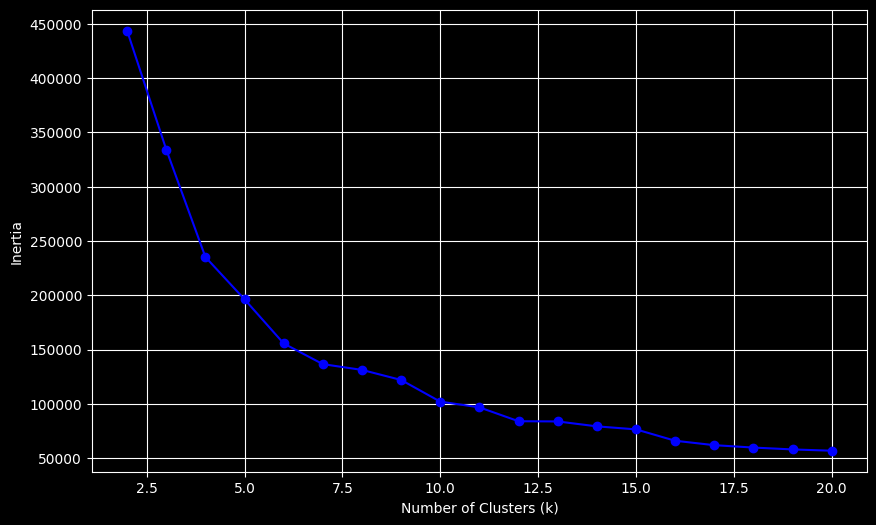

In [21]:
# Finding the optimal amount of clusters
df = pl.read_parquet("data/characteristics.parquet")

features = ["mean_rtt", "jitter", "mean_loss"]
X = df.select(features).to_numpy()

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

inertia = []
K = range(2, 21)
for k in K:
    km = KMeans(n_clusters=k, random_state=42, n_init=10)
    km.fit(X_scaled)
    inertia.append(km.inertia_)

plt.figure(figsize=(10, 6))
plt.plot(K, inertia, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()

In [22]:
# Splitting the IP addresses into clusters
df = pl.read_parquet("data/characteristics.parquet")

features = ["mean_rtt", "jitter", "mean_loss"]
X = df.select(features).to_numpy()

kmeans = KMeans(n_clusters=7)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
clusters = kmeans.fit_predict(X_scaled)

df = df.with_columns(pl.Series(name="cluster", values=clusters))

df.write_parquet("data/characteristics_clustered.parquet")

In [23]:
# Profile printout for KMeans clustering
df = pl.read_parquet("data/characteristics_clustered.parquet")
profile = (
    df.group_by("cluster")
    .agg([
        pl.col("mean_rtt").mean().alias("avg_latency"),
        pl.col("jitter").mean().alias("avg_jitter"),
        pl.col("mean_loss").mean().alias("avg_packet_loss"),
        pl.len().alias("ip_count")
    ]).sort("avg_latency")
)
print(profile)

shape: (7, 5)
┌─────────┬─────────────┬─────────────┬─────────────────┬──────────┐
│ cluster ┆ avg_latency ┆ avg_jitter  ┆ avg_packet_loss ┆ ip_count │
│ ---     ┆ ---         ┆ ---         ┆ ---             ┆ ---      │
│ i32     ┆ f64         ┆ f64         ┆ f64             ┆ u32      │
╞═════════╪═════════════╪═════════════╪═════════════════╪══════════╡
│ 0       ┆ 51.299964   ┆ 19.504793   ┆ 0.992901        ┆ 98765    │
│ 4       ┆ 92.149008   ┆ 29.377208   ┆ 13.658339       ┆ 27296    │
│ 6       ┆ 234.132129  ┆ 49.894263   ┆ 2.101494        ┆ 58440    │
│ 5       ┆ 240.119465  ┆ 377.706681  ┆ 2.828267        ┆ 6909     │
│ 3       ┆ 452.65439   ┆ 1092.64368  ┆ 5.578666        ┆ 1189     │
│ 1       ┆ 1575.015971 ┆ 2098.083646 ┆ 13.837595       ┆ 144      │
│ 2       ┆ 5349.834674 ┆ 4624.546869 ┆ 54.339537       ┆ 4        │
└─────────┴─────────────┴─────────────┴─────────────────┴──────────┘


In [24]:
# Visualizing KMeans clusters
visualize_profile_3d(df, "3D Visualization of Network Personalities (K-Means)")

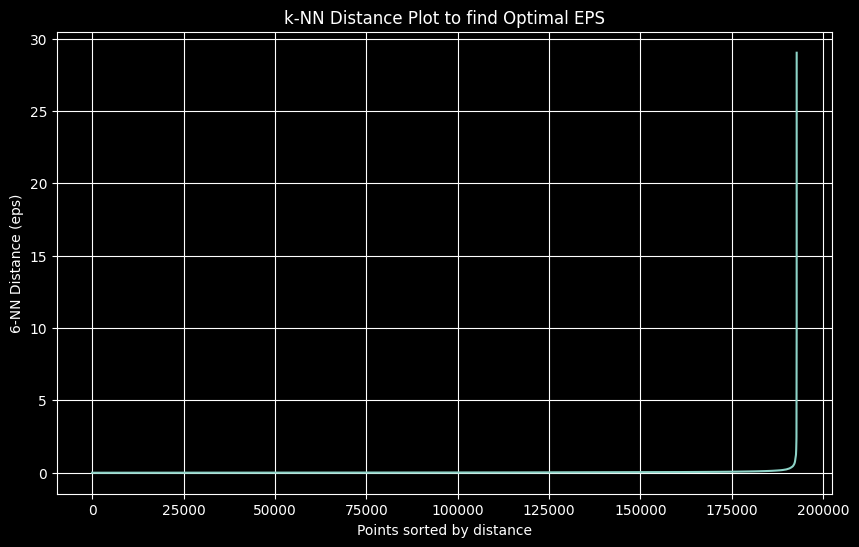

In [25]:
# Clustering IP addresses using DBSCAN
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
import numpy as np
import matplotlib.pyplot as plt

df = pl.read_parquet("data/characteristics.parquet")
features = ["mean_rtt", "jitter", "mean_loss"]
X = df.select(features).to_numpy()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


k = 6
neighbors = NearestNeighbors(n_neighbors=k)
neighbors_fit = neighbors.fit(X_scaled)
distances, indices = neighbors_fit.kneighbors(X_scaled)

sort_distances = np.sort(distances[:, k-1], axis=0)

plt.figure(figsize=(10, 6))
plt.plot(sort_distances)
plt.xlabel('Points sorted by distance')
plt.ylabel(f'{k}-NN Distance (eps)')
plt.title('k-NN Distance Plot to find Optimal EPS')
plt.grid(True)
plt.show()

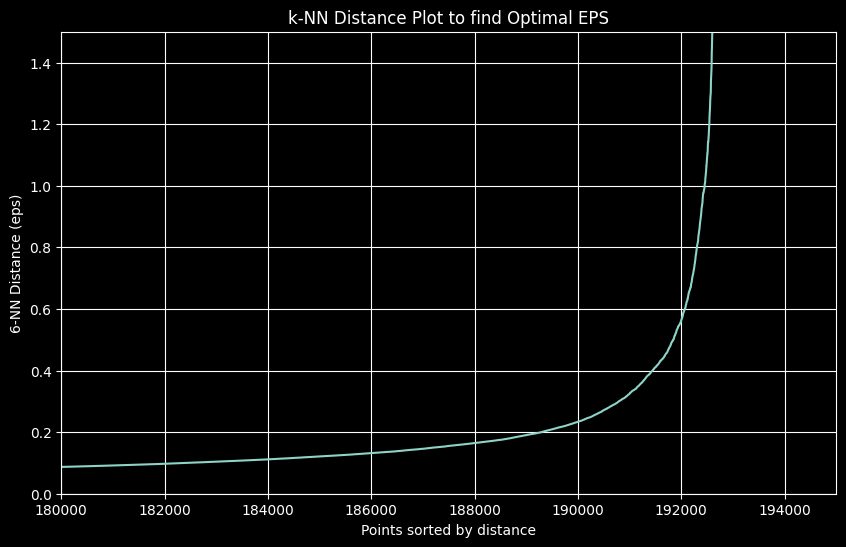

In [26]:
plt.figure(figsize=(10, 6))
plt.plot(sort_distances)

plt.xlim(180000, 195000)
plt.ylim(0, 1.5)

plt.xlabel('Points sorted by distance')
plt.ylabel(f'{k}-NN Distance (eps)')
plt.title('k-NN Distance Plot to find Optimal EPS')
plt.grid(True)
plt.show()

In [27]:
dbscan = DBSCAN(eps=0.5, min_samples=10)
db_clusters = dbscan.fit_predict(X_scaled)

df_dbscan = df = df.with_columns(pl.Series(name="cluster", values=db_clusters))
df.write_parquet("data/characteristics_clustered_dbscan.parquet")

In [28]:
# Profile printout for DBSCAN clustering
df = pl.read_parquet("data/characteristics_clustered_dbscan.parquet")
profile = (
    df.group_by("cluster")
    .agg([
        pl.col("mean_rtt").mean().alias("avg_latency"),
        pl.col("jitter").mean().alias("avg_jitter"),
        pl.col("mean_loss").mean().alias("avg_packet_loss"),
        pl.len().alias("ip_count")
    ]).sort("avg_latency")
)
with pl.Config(tbl_rows=-1):
    print(profile)

shape: (8, 5)
┌─────────┬─────────────┬─────────────┬─────────────────┬──────────┐
│ cluster ┆ avg_latency ┆ avg_jitter  ┆ avg_packet_loss ┆ ip_count │
│ ---     ┆ ---         ┆ ---         ┆ ---             ┆ ---      │
│ i32     ┆ f64         ┆ f64         ┆ f64             ┆ u32      │
╞═════════╪═════════════╪═════════════╪═════════════════╪══════════╡
│ 6       ┆ 9.768613    ┆ 6.512625    ┆ 86.268233       ┆ 23       │
│ 0       ┆ 119.959199  ┆ 46.025805   ┆ 3.148972        ┆ 191728   │
│ 4       ┆ 319.389787  ┆ 1061.107785 ┆ 8.436311        ┆ 8        │
│ 5       ┆ 592.347106  ┆ 1164.306901 ┆ 5.216015        ┆ 13       │
│ 2       ┆ 691.168752  ┆ 1283.566563 ┆ 5.875151        ┆ 26       │
│ -1      ┆ 717.88613   ┆ 1087.405754 ┆ 17.508279       ┆ 884      │
│ 3       ┆ 723.227935  ┆ 1476.446978 ┆ 6.230303        ┆ 17       │
│ 1       ┆ 731.684459  ┆ 114.452041  ┆ 9.89969         ┆ 48       │
└─────────┴─────────────┴─────────────┴─────────────────┴──────────┘


In [29]:
# Visualizing initial DBSCAN clusters
visualize_profile_3d(df, "3D Visualization of Network Personalities (DBSCAN)")

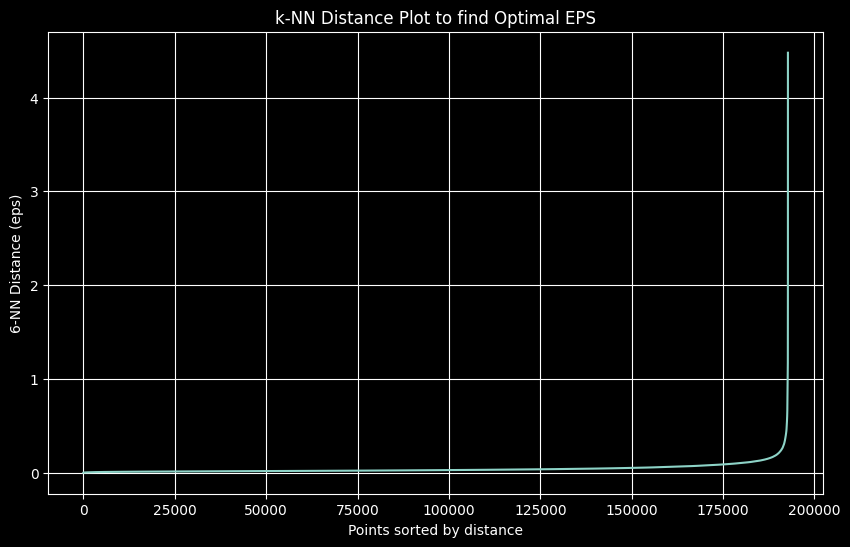

In [30]:
# Trying out log scaling on DBSCAN, whether it doesn't concentrate that many IP addresses into a single cluster
df = pl.read_parquet("data/characteristics.parquet")
df = df.with_columns([
    (pl.col("mean_rtt") + 1).log().alias("mean_rtt_log"),
    (pl.col("jitter") + 1).log().alias("jitter_log")
])

features = ["mean_rtt_log", "jitter_log", "mean_loss"]
X = df.select(features).to_numpy()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

k = 6
neighbors = NearestNeighbors(n_neighbors=k)
neighbors_fit = neighbors.fit(X_scaled)
distances, indices = neighbors_fit.kneighbors(X_scaled)

sort_distances = np.sort(distances[:, k-1], axis=0)

plt.figure(figsize=(10, 6))
plt.plot(sort_distances)
plt.xlabel('Points sorted by distance')
plt.ylabel(f'{k}-NN Distance (eps)')
plt.title('k-NN Distance Plot to find Optimal EPS')
plt.grid(True)
plt.show()

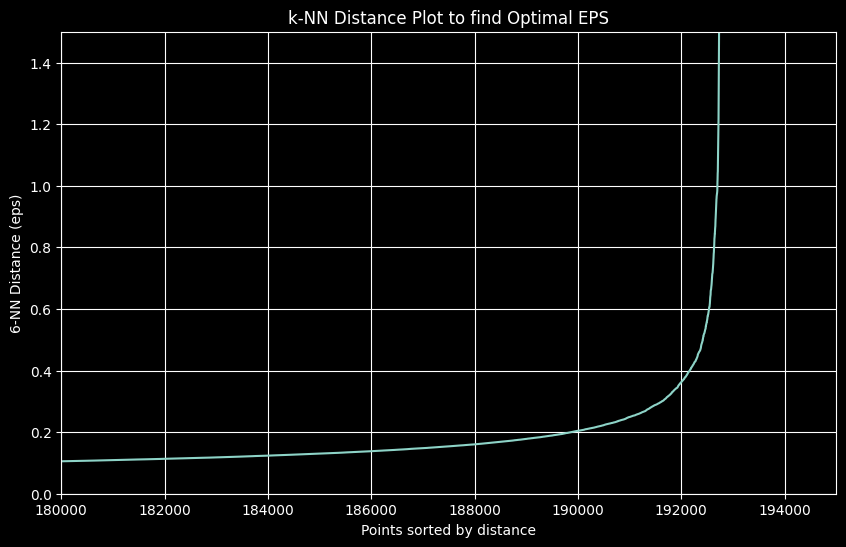

In [31]:
plt.figure(figsize=(10, 6))
plt.plot(sort_distances)

plt.xlim(180000, 195000)
plt.ylim(0, 1.5)

plt.xlabel('Points sorted by distance')
plt.ylabel(f'{k}-NN Distance (eps)')
plt.title('k-NN Distance Plot to find Optimal EPS')
plt.grid(True)
plt.show()

In [32]:
dbscan = DBSCAN(eps=0.4, min_samples=10)
db_clusters = dbscan.fit_predict(X_scaled)

df_dbscan = df = df.with_columns(pl.Series(name="cluster", values=db_clusters))
df.write_parquet("data/characteristics_clustered_dbscan_log.parquet")

In [33]:
# Profile printout for log DBSCAN clustering
df = pl.read_parquet("data/characteristics_clustered_dbscan_log.parquet")
profile = (
    df.group_by("cluster")
    .agg([
        pl.col("mean_rtt").mean().alias("avg_latency"),
        pl.col("jitter").mean().alias("avg_jitter"),
        pl.col("mean_loss").mean().alias("avg_packet_loss"),
        pl.len().alias("ip_count")
    ]).sort("avg_latency")
)
with pl.Config(tbl_rows=-1):
    print(profile)

shape: (5, 5)
┌─────────┬─────────────┬────────────┬─────────────────┬──────────┐
│ cluster ┆ avg_latency ┆ avg_jitter ┆ avg_packet_loss ┆ ip_count │
│ ---     ┆ ---         ┆ ---        ┆ ---             ┆ ---      │
│ i32     ┆ f64         ┆ f64        ┆ f64             ┆ u32      │
╞═════════╪═════════════╪════════════╪═════════════════╪══════════╡
│ 1       ┆ 0.040229    ┆ 0.044916   ┆ 0.000422        ┆ 13       │
│ 3       ┆ 6.976218    ┆ 6.989122   ┆ 85.488331       ┆ 14       │
│ 2       ┆ 23.697963   ┆ 23.336934  ┆ 71.359408       ┆ 11       │
│ 0       ┆ 122.539543  ┆ 50.634315  ┆ 3.101227        ┆ 192145   │
│ -1      ┆ 291.304308  ┆ 255.243608 ┆ 42.924691       ┆ 564      │
└─────────┴─────────────┴────────────┴─────────────────┴──────────┘


In [34]:
# Visualizing log DBSCAN clusters
visualize_profile_3d(df, "3D Visualization of Network Personalities (DBSCAN-log)")

In [35]:
# HDBSCAN
from cuml.cluster import HDBSCAN
hdb = HDBSCAN(min_cluster_size=70)
df = pl.read_parquet("data/characteristics.parquet")

features = ["mean_rtt", "jitter", "mean_loss"]
X = df.select(features).to_numpy()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_gpu = cp.array(X_scaled)
clusters = hdb.fit_predict(X_gpu)
df_hdbscan = df = df.with_columns(pl.Series(name="cluster", values=clusters))
df.write_parquet("data/characteristics_clustered_hdbscan.parquet")

[2026-01-01 12:35:48.900] [CUML] [warning] Using data on device memory because knn_n_clusters = 1.


In [36]:
# Profile printout for HDBSCAN clustering
df = pl.read_parquet("data/characteristics_clustered_hdbscan.parquet")
profile = (
    df.group_by("cluster")
    .agg([
        pl.col("mean_rtt").mean().alias("avg_latency"),
        pl.col("jitter").mean().alias("avg_jitter"),
        pl.col("mean_loss").mean().alias("avg_packet_loss"),
        pl.len().alias("ip_count")
    ]).sort("avg_latency")
)
with pl.Config(tbl_rows=-1):
    print(profile)

shape: (18, 5)
┌─────────┬─────────────┬────────────┬─────────────────┬──────────┐
│ cluster ┆ avg_latency ┆ avg_jitter ┆ avg_packet_loss ┆ ip_count │
│ ---     ┆ ---         ┆ ---        ┆ ---             ┆ ---      │
│ i64     ┆ f64         ┆ f64        ┆ f64             ┆ u32      │
╞═════════╪═════════════╪════════════╪═════════════════╪══════════╡
│ 4       ┆ 18.132698   ┆ 3.529351   ┆ 14.394337       ┆ 906      │
│ 14      ┆ 23.278263   ┆ 8.19754    ┆ 0.114201        ┆ 42535    │
│ 7       ┆ 25.770522   ┆ 4.888298   ┆ 7.91306         ┆ 128      │
│ 13      ┆ 51.819523   ┆ 16.822758  ┆ 3.352945        ┆ 2733     │
│ 9       ┆ 61.258009   ┆ 23.030224  ┆ 9.336856        ┆ 11668    │
│ 1       ┆ 67.480259   ┆ 112.785202 ┆ 8.105533        ┆ 133      │
│ 12      ┆ 100.710499  ┆ 30.727338  ┆ 0.033644        ┆ 82       │
│ 2       ┆ 110.207896  ┆ 4.695546   ┆ 14.197792       ┆ 267      │
│ 16      ┆ 120.006866  ┆ 6.931973   ┆ 0.081264        ┆ 10515    │
│ -1      ┆ 161.769435  ┆ 77.6486

In [37]:
visualize_profile_3d(df, "3D Visualization of Network Personalities (HDBSCAN)")